In [3]:
import turicreate as tc
import matplotlib.pyplot as plt

In [4]:
train_data = tc\
    .image_analysis\
    .load_images('snacks/train', with_path=True)

In [6]:
len(train_data)

4838

In [7]:
train_data.head()

path,image
snacks/train/apple/007a0bec00a90a66.jpg ...,Height: 341 Width: 256
snacks/train/apple/007ec56b6529e036.jpg ...,Height: 256 Width: 341
snacks/train/apple/00881627629888f6.jpg ...,Height: 256 Width: 384
snacks/train/apple/00bb5720a7ba062e.jpg ...,Height: 256 Width: 341
snacks/train/apple/00cc1c601b23f73d.jpg ...,Height: 256 Width: 341
snacks/train/apple/01477ea37494a8ac.jpg ...,Height: 256 Width: 382
snacks/train/apple/018257a792aa90e6.jpg ...,Height: 256 Width: 256
snacks/train/apple/01968ea73417ec3b.jpg ...,Height: 256 Width: 256
snacks/train/apple/01ecc03a12e21e39.jpg ...,Height: 256 Width: 446
snacks/train/apple/021d2569ce62aa93.jpg ...,Height: 256 Width: 341


/Users/jc/opt/anaconda3/envs/turienv/lib/python3.7/site-packages/turicreate/visualization/_plot.py:376: UserWarning: Displaying only the first 100 rows.
  warnings.warn('Displaying only the first {} rows.'.format(maximum_rows))


,path,image
0,snacks/train/apple/007a0bec00a90a66.jpg,
1,snacks/train/apple/007ec56b6529e036.jpg,
2,snacks/train/apple/00881627629888f6.jpg,
3,snacks/train/apple/00bb5720a7ba062e.jpg,
4,snacks/train/apple/00cc1c601b23f73d.jpg,
5,snacks/train/apple/01477ea37494a8ac.jpg,
6,snacks/train/apple/018257a792aa90e6.jpg,
7,snacks/train/apple/01968ea73417ec3b.jpg,
8,snacks/train/apple/01ecc03a12e21e39.jpg,
9,snacks/train/apple/021d2569ce62aa93.jpg,

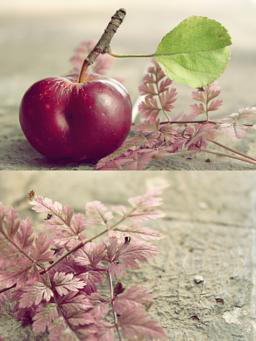
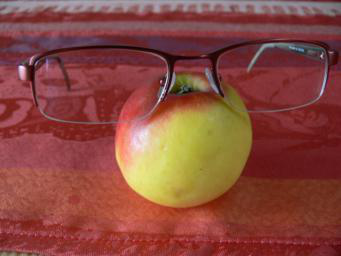
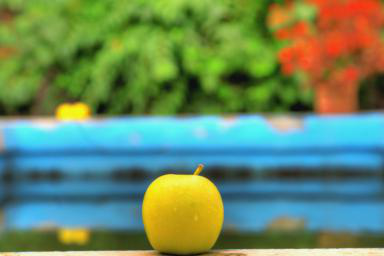
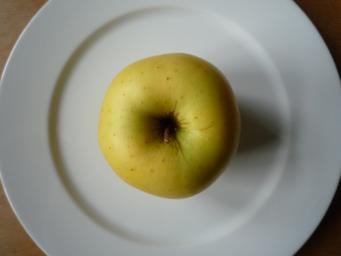
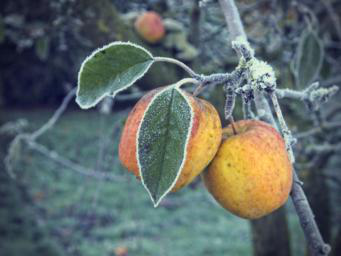
...
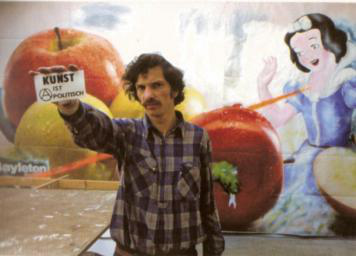
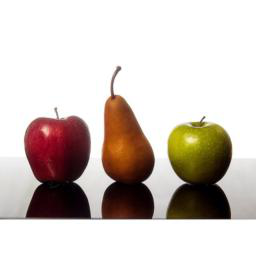
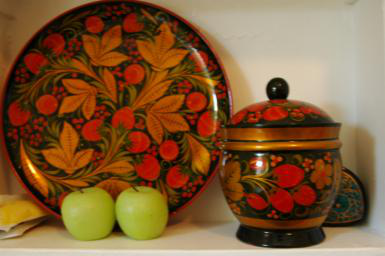
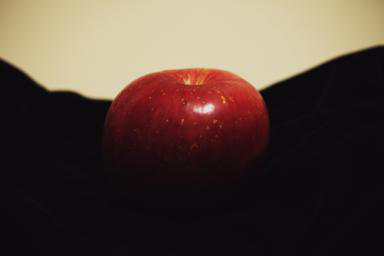
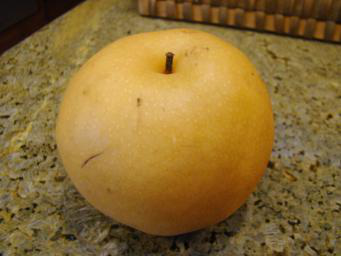

In [8]:
train_data.explore()

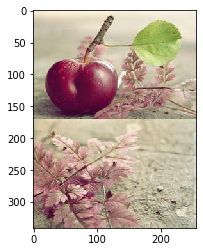

In [10]:
plt.imshow(train_data[0]['image'].pixel_data)

In [13]:
path = train_data[0]['path']
print(path)

snacks/train/apple/007a0bec00a90a66.jpg


In [15]:
import os
os.path.basename(os.path.split(path)[0])

'apple'

In [24]:
train_data["label"] = train_data['path'].apply(lambda p: os.path.basename(os.path.split(p)[0]))

,path,image,labal,label
0,snacks/train/apple/007a0bec00a90a66.jpg,,apple,apple
1,snacks/train/apple/007ec56b6529e036.jpg,,apple,apple
2,snacks/train/apple/00881627629888f6.jpg,,apple,apple
3,snacks/train/apple/00bb5720a7ba062e.jpg,,apple,apple
4,snacks/train/apple/00cc1c601b23f73d.jpg,,apple,apple
5,snacks/train/apple/01477ea37494a8ac.jpg,,apple,apple
6,snacks/train/apple/018257a792aa90e6.jpg,,apple,apple
7,snacks/train/apple/01968ea73417ec3b.jpg,,apple,apple
8,snacks/train/apple/01ecc03a12e21e39.jpg,,apple,apple
9,snacks/train/apple/021d2569ce62aa93.jpg,,apple,apple

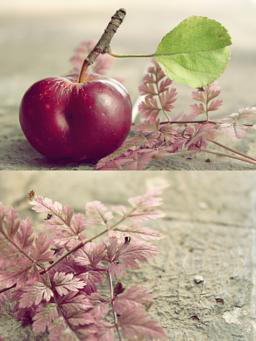
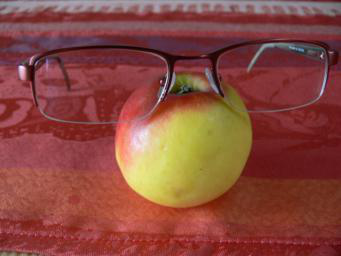
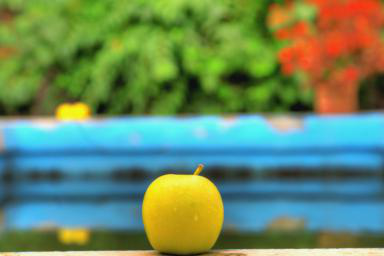
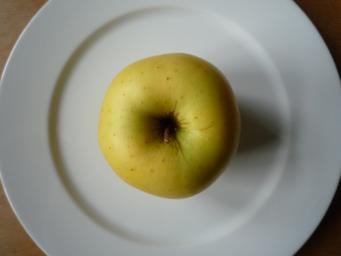
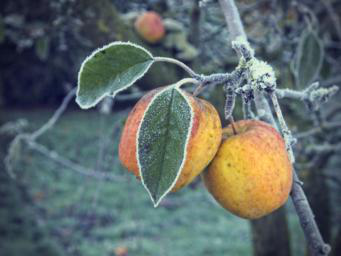
...
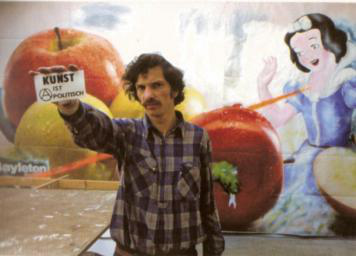
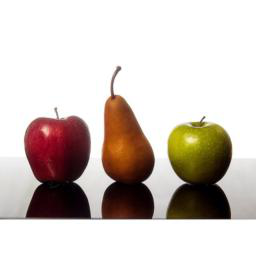
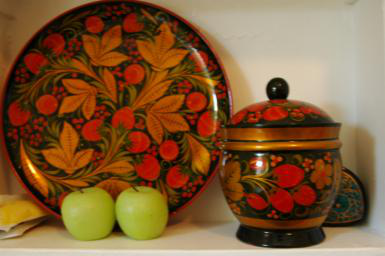
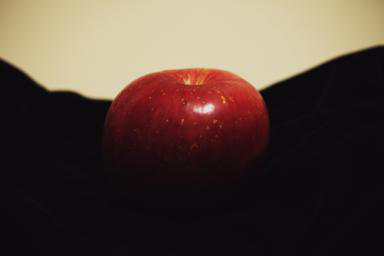
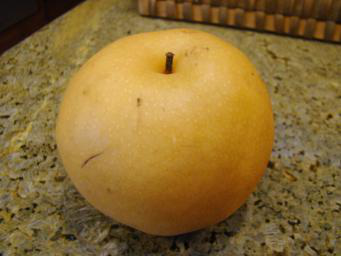

,path,image,labal,label
0,snacks/train/apple/007a0bec00a90a66.jpg,,apple,apple
1,snacks/train/apple/007ec56b6529e036.jpg,,apple,apple
2,snacks/train/apple/00881627629888f6.jpg,,apple,apple
3,snacks/train/apple/00bb5720a7ba062e.jpg,,apple,apple
4,snacks/train/apple/00cc1c601b23f73d.jpg,,apple,apple
5,snacks/train/apple/01477ea37494a8ac.jpg,,apple,apple
6,snacks/train/apple/018257a792aa90e6.jpg,,apple,apple
7,snacks/train/apple/01968ea73417ec3b.jpg,,apple,apple
8,snacks/train/apple/01ecc03a12e21e39.jpg,,apple,apple
9,snacks/train/apple/021d2569ce62aa93.jpg,,apple,apple

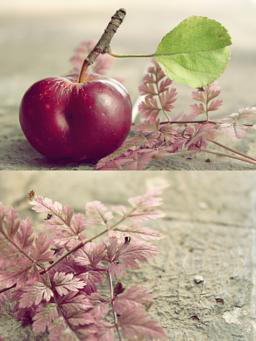
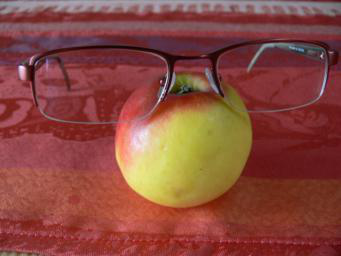
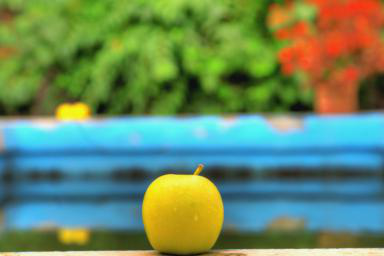
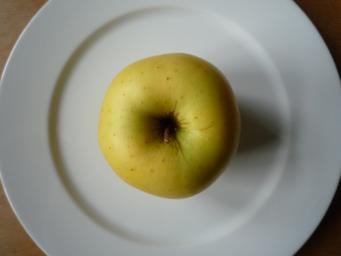
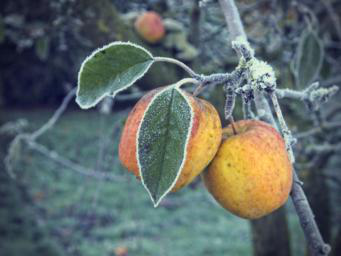
...
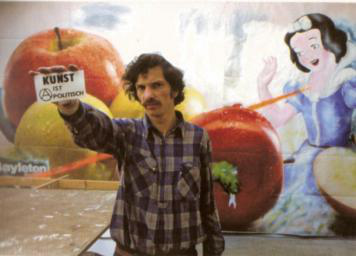
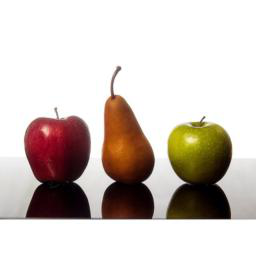
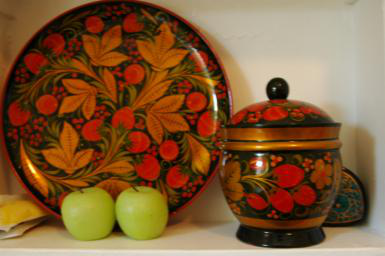
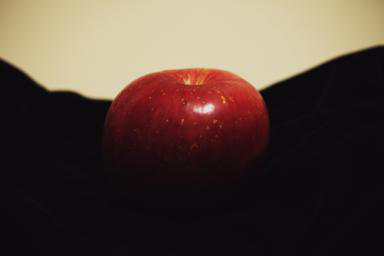
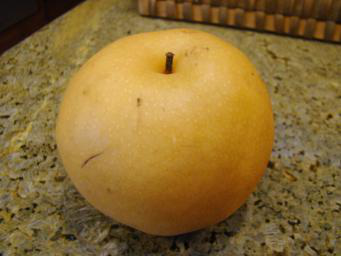

In [27]:
train_data.explore()

In [29]:
train_data["label"].summary()


+------------------+-------+----------+
|       item       | value | is exact |
+------------------+-------+----------+
|      Length      |  4838 |   Yes    |
| # Missing Values |   0   |   Yes    |
| # unique values  |   20  |    No    |
+------------------+-------+----------+

Most frequent items:
+-----------+-------+
|   value   | count |
+-----------+-------+
| pineapple |  260  |
|   apple   |  250  |
|   banana  |  250  |
|  doughnut |  250  |
|   grape   |  250  |
|  hot dog  |  250  |
| ice cream |  250  |
|   juice   |  250  |
|   muffin  |  250  |
|   salad   |  250  |
+-----------+-------+


In [30]:
train_data["label"].value_counts().print_rows(num_rows=20)

+------------+-------+
|   value    | count |
+------------+-------+
| pineapple  |  260  |
|   juice    |  250  |
|   banana   |  250  |
|   apple    |  250  |
|  doughnut  |  250  |
| watermelon |  250  |
|   waffle   |  250  |
|   muffin   |  250  |
|   salad    |  250  |
| ice cream  |  250  |
|  hot dog   |  250  |
|   grape    |  250  |
|   carrot   |  249  |
|    cake    |  249  |
|   cookie   |  249  |
|   orange   |  249  |
|   candy    |  249  |
| strawberry |  249  |
|  popcorn   |  180  |
|  pretzel   |  154  |
+------------+-------+
[20 rows x 2 columns]



/Users/jc/opt/anaconda3/envs/turienv/lib/python3.7/site-packages/turicreate/aggregate.py:91: UserWarning: Passing parameter(s) to COUNT is deprecated. This functionality will be removed in the next major release. Any passed parameters are ignored.
  warnings.warn('Passing parameter(s) to COUNT is deprecated. This functionality will be removed in '


In [38]:
# model = tc.image_classifier.create(train_data,
#                                    target="label",
#                                    model="VisionFeaturePrint_Scene",
#                                    verbose=True,
#                                    max_iterations=15)

model = tc.load_model("HealthySnacks.model")

Analyzing and extracting image features.

+------------------+--------------+------------------+

| Images Processed | Elapsed Time | Percent Complete |

+------------------+--------------+------------------+

ToolkitError: CoreML Error: Failed to obtain prediction for sample 0

In [40]:
test_data = tc.image_analysis.load_images("snacks/test", with_path=True)
test_data["label"] = test_data["path"].apply(lambda path:
       os.path.basename(os.path.split(path)[0]))

len(test_data)

952

In [41]:
metrics = model.evaluate(test_data)

Analyzing and extracting image features.

+------------------+--------------+------------------+

| Images Processed | Elapsed Time | Percent Complete |

+------------------+--------------+------------------+

ToolkitError: CoreML Error: Failed to obtain prediction for sample 0